In [1]:
%load_ext autoreload
%autoreload 2

## Import Dependency

In [28]:
import os
import torch
import warnings
import IPython.display
import librosa.display
from IPython.display import Audio, display
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.manifold import TSNE


import numpy as np
from utils.measuring_performance import plot_histogram_by_class
from utils.misc import download_and_unzip_file
from utils.sound_utils import load_sound_file, extract_sound_features, extract_gsensor_features

In [25]:
# Ignore all warning messages (use with caution)
warnings.filterwarnings("ignore")

# Set the plot style
plt.style.use("Solarize_Light2")
prop_cycle = plt.rcParams["axes.prop_cycle"]
colors = prop_cycle.by_key()["color"]
COL_NORMAL, COL_ABNORM = colors[1], colors[5]


In [4]:
DATA_PATH = Path("./data/tsri_factory")
IMAGE_PATH = "./img"

def print_tree(path: Path, level=0, max_level=2):

    indent = "    " * level
    if path.is_dir():
        print(f"{indent}📁 {path.name}/")
        if level < max_level:
            for item in sorted(path.iterdir()):
                print_tree(item, level + 1, max_level)
    else:
        print(f"{indent}📄 {path.name}")

if not DATA_PATH.exists():
    print("❌ Folder does not exist.")
else:
    print_tree(DATA_PATH, max_level=2)

📁 tsri_factory/
    📁 dataset/
        📄 test_data_combined.pkl
        📄 test_file_slices.pkl
        📄 test_filenames.pkl
        📄 test_files.txt
        📄 test_frame_counts.pkl
        📄 test_labels.txt
        📄 train_data_combined.pkl
        📄 train_data_combinedv1.pkl
        📄 train_file_slices.pkl
        📄 train_filenames.pkl
        📄 train_files.txt
        📄 train_frame_counts.pkl
        📄 train_labels.txt
    📁 gsensor/
        📁 abnormal/
        📁 normal/
    📁 sound/
        📁 abnormal/
        📁 normal/


# Exploratory Data Analysis
The recording file for each mechanical equipment contains a total of 8 channels, one for each microphone used to record sound. The rest of this experiment focuses on what was recorded with the first microphone. Let"s do an EDA by selecting a pair of normal and abnormal 10-second sound wave files.

## sound signal

In [5]:
file_id = "000006.wav"

In [6]:
normal_sound_file = os.path.join(DATA_PATH, "sound", "normal", file_id)
abnormal_sound_file = os.path.join(DATA_PATH, "sound", "abnormal", file_id)

normal_sound_signal, _ = load_sound_file(normal_sound_file)
abnormal_sound_signal, sr1 = load_sound_file(abnormal_sound_file)

print(f"Sound Signal shape: {abnormal_sound_signal.shape}, sample rate: {sr1} Hz")
print(f"Sound Signal duration: {abnormal_sound_signal.shape[0] / sr1:.2f} seconds")

Sound Signal shape: (2880000,), sample rate: 48000 Hz
Sound Signal duration: 60.00 seconds


In [7]:
print("Normal Sound Signal:")
display(Audio(normal_sound_file, rate=sr1))
print("Abnormal Sound Signal:")
display(Audio(abnormal_sound_file, rate=sr1))


Normal Sound Signal:


Abnormal Sound Signal:


## gsensor signal

In [8]:
normal_gsensor_file = os.path.join(DATA_PATH, "gsensor", "normal", file_id)
abnormal_gsensor_file = os.path.join(DATA_PATH, "gsensor", "abnormal", file_id)

normal_gsensor_signal, _ = load_sound_file(normal_gsensor_file)
abnormal_gsensor_signal, sr2 = load_sound_file(abnormal_gsensor_file)

print(f"Gsensor Signal shape: {abnormal_gsensor_signal.shape}, sample rate: {sr2} Hz")
print(f"Gsensor Signal duration: {abnormal_gsensor_signal.shape[0] / sr2:.2f} seconds")

Gsensor Signal shape: (216000,), sample rate: 3600 Hz
Gsensor Signal duration: 60.00 seconds


In [9]:
print("Normal gsensor Signal:")
display(Audio(normal_gsensor_file, rate=sr2))
print("Abnormal gsensor Signal:")
display(Audio(abnormal_gsensor_file, rate=sr2))

Normal gsensor Signal:


Abnormal gsensor Signal:


## Wave Forms

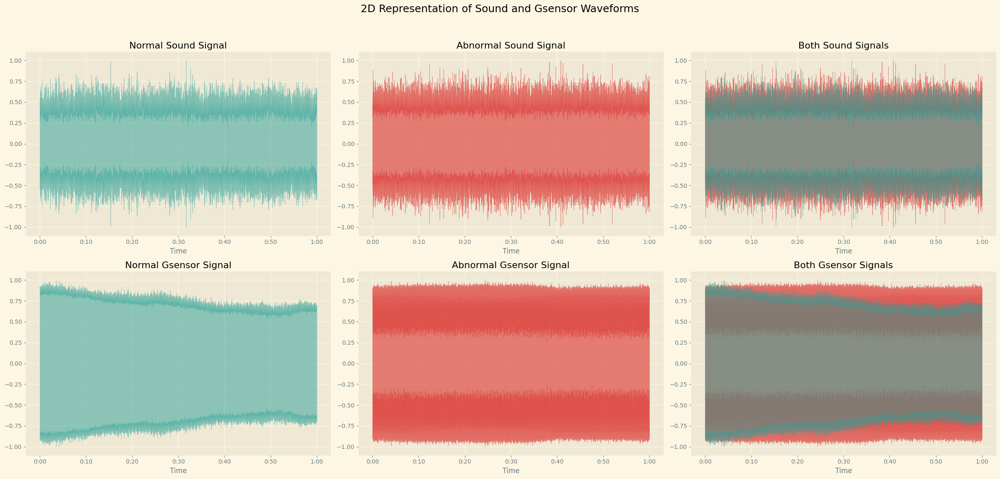

In [10]:
fig = plt.figure(figsize=(24, 12)) 

### Sound Signal Wave — First Row
plt.subplot(2, 3, 1)
librosa.display.waveshow(
    normal_sound_signal,
    sr=sr1,
    alpha=0.5,
    color=colors[1],
    linewidth=0.5,
    label="Normal Sound Signal",
)
plt.title("Normal Sound Signal")

plt.subplot(2, 3, 2)
librosa.display.waveshow(
    abnormal_sound_signal,
    sr=sr1,
    alpha=0.6,
    color=colors[5],
    linewidth=0.5,
    label="Abnormal Sound Signal",
)
plt.title("Abnormal Sound Signal")

plt.subplot(2, 3, 3)
librosa.display.waveshow(
    abnormal_sound_signal,
    sr=sr1,
    alpha=0.6,
    color=colors[5],
    linewidth=0.5,
    label="Abnormal Sound Signal",
)
librosa.display.waveshow(
    normal_sound_signal,
    sr=sr1,
    alpha=0.5,
    color=colors[1],
    linewidth=0.5,
    label="Normal Sound Signal",
)
plt.title("Both Sound Signals")

### Gsensor Signal Wave — Second Row
plt.subplot(2, 3, 4)
librosa.display.waveshow(
    normal_gsensor_signal,
    sr=sr2,
    alpha=0.5,
    color=colors[1],
    linewidth=0.5,
    label="Normal Gsensor Signal",
)
plt.title("Normal Gsensor Signal")

plt.subplot(2, 3, 5)
librosa.display.waveshow(
    abnormal_gsensor_signal,
    sr=sr2,
    alpha=0.6,
    color=colors[5],
    linewidth=0.5,
    label="Abnormal Gsensor Signal",
)
plt.title("Abnormal Gsensor Signal")

plt.subplot(2, 3, 6)
librosa.display.waveshow(
    abnormal_gsensor_signal,
    sr=sr2,
    alpha=0.6,
    color=colors[5],
    linewidth=0.5,
    label="Abnormal Gsensor Signal",
)
librosa.display.waveshow(
    normal_gsensor_signal,
    sr=sr2,
    alpha=0.5,
    color=colors[1],
    linewidth=0.5,
    label="Normal Gsensor Signal",
)
plt.title("Both Gsensor Signals")

fig.suptitle("2D Representation of Sound and Gsensor Waveforms", fontsize=18)

# Optional: Place legend outside the plots
# plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=2)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # 防止 suptitle 被擠掉
plt.show()

# Save figure
fig.savefig(os.path.join(IMAGE_PATH, "wave_forms.svg"), format="svg")


## Short Time Fourier Tranform

比較兩段聲音（正常與異常）在最開頭的頻率特性，透過 STFT 只計算一個 window的頻譜，觀察差異。

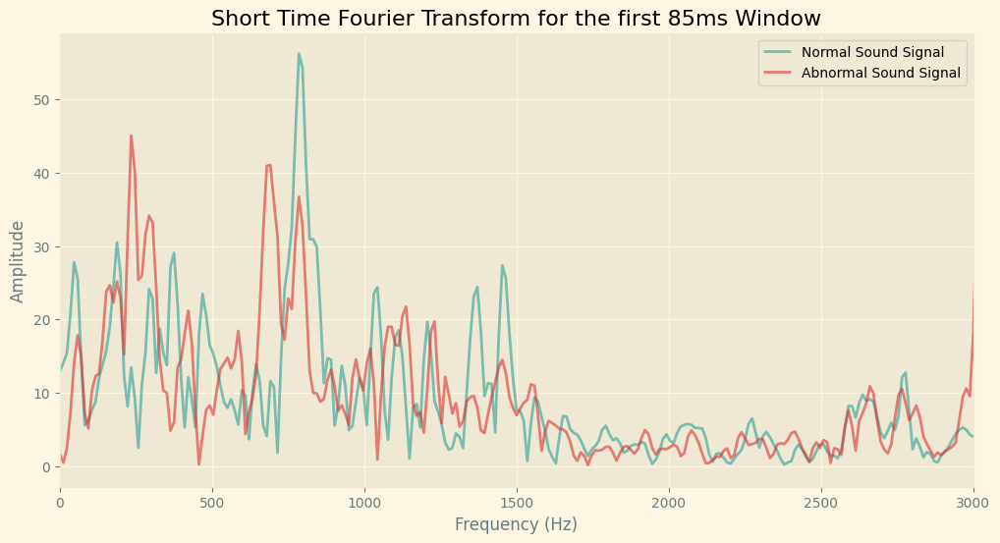

In [11]:
## Sound Signal
s_freq_limit = 3000
n_fft = 4096
hop_length = n_fft 

# 取前 n_fft 樣本做 STFT，只取第一個 frame
normal_stft = np.abs(librosa.stft(normal_sound_signal[:n_fft], n_fft=n_fft, hop_length=hop_length))[:, 0]
abnormal_stft = np.abs(librosa.stft(abnormal_sound_signal[:n_fft], n_fft=n_fft, hop_length=hop_length))[:, 0]

# 對應的頻率軸（Hz）
freqs = librosa.fft_frequencies(sr=sr1, n_fft=n_fft)
low_freq_indices = freqs <= s_freq_limit

# 篩選頻率軸與 STFT 結果
freqs_low = freqs[low_freq_indices]
normal_stft_low = normal_stft[low_freq_indices]
abnormal_stft_low = abnormal_stft[low_freq_indices]


# 繪圖
fig = plt.figure(figsize=(12, 6))
plt.plot(freqs, normal_stft, color=colors[1], alpha=0.6, label="Normal Sound Signal")
plt.plot(freqs, abnormal_stft, color=colors[5], alpha=0.6, label="Abnormal Sound Signal")
plt.title(f"Short Time Fourier Transform for the first {n_fft / sr1 * 1000:.0f}ms Window")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Amplitude")
plt.legend()
plt.xlim(0, s_freq_limit)
plt.show()

fig.savefig(os.path.join(IMAGE_PATH, "stft_sound.svg"), format="svg")

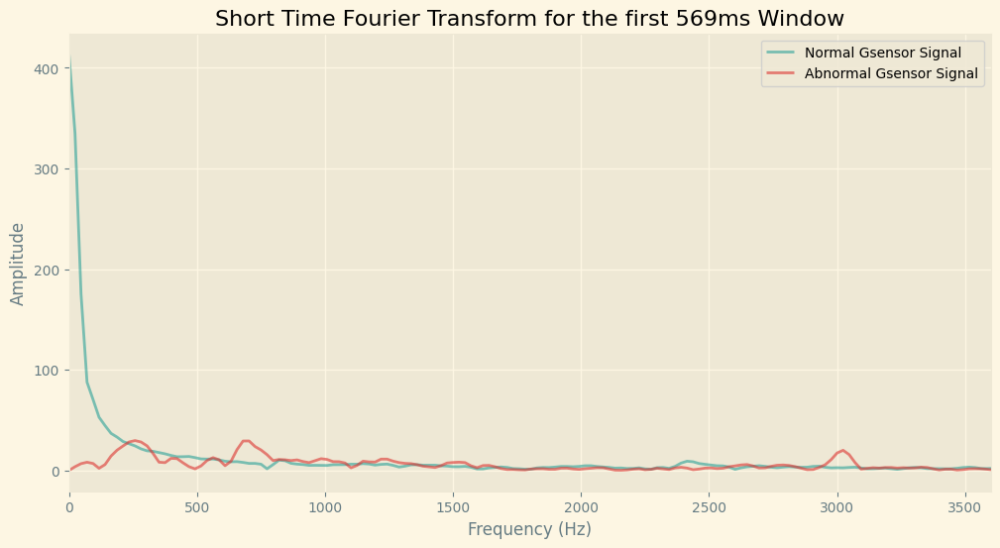

In [12]:
## gsensor Signal
g_freq_limit = sr2
n_fft = 2048
hop_length = n_fft 
# 取前 n_fft 樣本做 STFT，只取第一個 frame
normal_stft = np.abs(librosa.stft(normal_gsensor_signal[:n_fft], n_fft=n_fft, hop_length=hop_length))[:, 0]
abnormal_stft = np.abs(librosa.stft(abnormal_sound_signal[:n_fft], n_fft=n_fft, hop_length=hop_length))[:, 0]

# 對應的頻率軸（Hz）
freqs = librosa.fft_frequencies(sr=sr1, n_fft=n_fft)
low_freq_indices = freqs <= g_freq_limit

# 篩選頻率軸與 STFT 結果
freqs_low = freqs[low_freq_indices]
normal_stft_low = normal_stft[low_freq_indices]
abnormal_stft_low = abnormal_stft[low_freq_indices]

# 繪圖
fig = plt.figure(figsize=(12, 6))
plt.plot(freqs, normal_stft, color=colors[1], alpha=0.6, label="Normal Gsensor Signal")
plt.plot(freqs, abnormal_stft, color=colors[5], alpha=0.6, label="Abnormal Gsensor Signal")
plt.title(f"Short Time Fourier Transform for the first {n_fft / sr2 * 1000:.0f}ms Window")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Amplitude")
plt.legend()
plt.xlim(0, g_freq_limit)
plt.show()

fig.savefig(os.path.join(IMAGE_PATH, "stft_gsensor.svg"), format="svg")

## Sound Signal

### Spectrograms (dB scale)

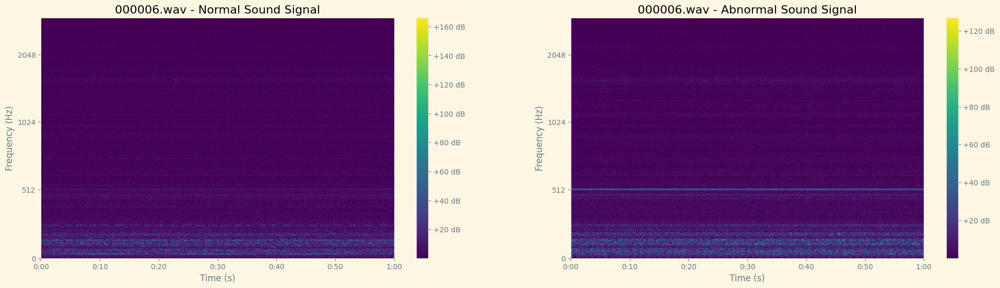

The spectrograms have a (1025, 422) shape.


In [ ]:
# Sound Signal
hop_length = 512
normal_stft = np.abs(librosa.stft(normal_sound_signal, n_fft=n_fft, hop_length=hop_length))
# normal_spectrogram = librosa.amplitude_to_db(normal_stft, ref=np.max)

abnormal_stft = np.abs(librosa.stft(abnormal_sound_signal, n_fft=n_fft, hop_length=hop_length))
# abnormal_spectrogram = librosa.amplitude_to_db(abnormal_stft, ref=np.max)

fig = plt.figure(figsize=(24, 6))

plt.subplot(1, 2, 1)
librosa.display.specshow(
    normal_spectrogram, sr=sr1, x_axis="time", y_axis="mel", cmap="viridis"
)
plt.ylim(0, s_freq_limit) 
plt.title(f"{file_id} - Normal Sound Signal")
plt.colorbar(format="%+2.f dB")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")

plt.subplot(1, 2, 2)
librosa.display.specshow(
    abnormal_spectrogram, sr=sr1, x_axis="time", y_axis="mel", cmap="viridis"
)
plt.ylim(0, s_freq_limit) 
plt.title(f"{file_id} - Abnormal Sound Signal")
plt.ylabel("Frequency (Hz)")
plt.colorbar(format="%+2.f dB")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")

plt.show()
fig.savefig(os.path.join(IMAGE_PATH, "spectrograms.svg"), format="svg")

print(f"The spectrograms have a {normal_spectrogram.shape} shape.")

### Mel-Spectrograms

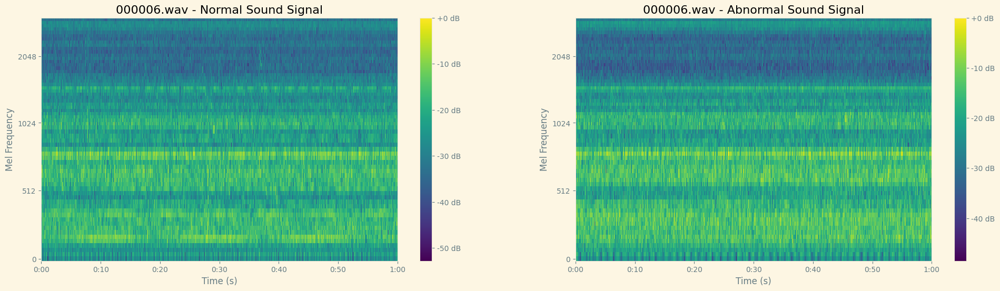

The mel-spectrograms have a (64, 5626) shape.


In [14]:
# Sound Signal
n_mels = 64
normal_mel_spectrogram = librosa.feature.melspectrogram(
    y=normal_sound_signal, sr=sr1, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels, fmax=s_freq_limit
)
normal_mel_spectrogram = librosa.power_to_db(normal_mel_spectrogram, ref=np.max)

abnormal_mel_spectrogram = librosa.feature.melspectrogram(
    y=abnormal_sound_signal, sr=sr1, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels, fmax=s_freq_limit
)
abnormal_mel_spectrogram = librosa.power_to_db(abnormal_mel_spectrogram, ref=np.max)

fig = plt.figure(figsize=(24, 6))

plt.subplot(1, 2, 1)
librosa.display.specshow(
    normal_mel_spectrogram,
    sr=sr1,
    hop_length=hop_length,
    x_axis="time",
    y_axis="mel",
    cmap="viridis",
    fmax=s_freq_limit
)
plt.title(f"{file_id} - Normal Sound Signal")
plt.xlabel("Time (s)")
plt.ylabel("Mel Frequency")
plt.colorbar(format="%+2.0f dB")

plt.subplot(1, 2, 2)
librosa.display.specshow(
    abnormal_mel_spectrogram,
    sr=sr1,
    hop_length=hop_length,
    x_axis="time",
    y_axis="mel",
    cmap="viridis",
    fmax=s_freq_limit
)
plt.title(f"{file_id} - Abnormal Sound Signal")
plt.xlabel("Time (s)")
plt.ylabel("Mel Frequency")
plt.colorbar(format="%+2.0f dB")

plt.show()

fig.savefig(os.path.join(IMAGE_PATH, "mel_spectrograms.svg"), format="svg")

print(f"The mel-spectrograms have a {normal_mel_spectrogram.shape} shape.")


### Multiple Frames of Spectrograms

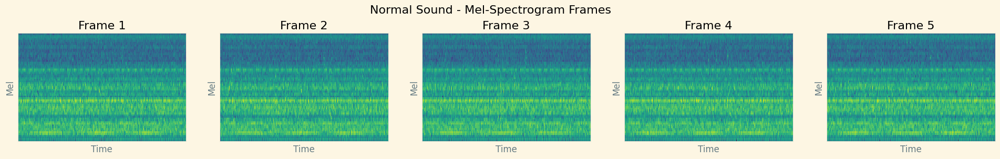

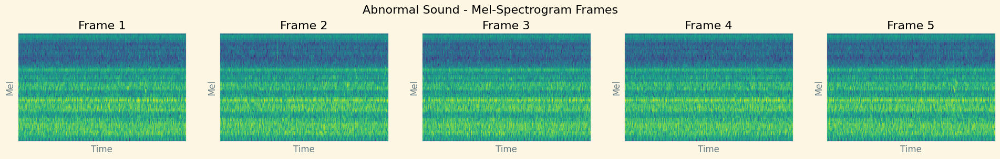

The features have a (5622, 320) shape.


In [15]:
### Multiple Frames of Spectrograms
frames = 5
dims = frames * n_mels

# Normal Sound
features_vector_size = normal_mel_spectrogram.shape[1] - frames + 1
features = np.zeros((features_vector_size, dims), np.float32)
for t in range(frames):
    features[:, n_mels * t : n_mels * (t + 1)] = normal_mel_spectrogram[:, t : t + features_vector_size].T

fig = plt.figure(figsize=(24, 3))
fig.suptitle("Normal Sound - Mel-Spectrogram Frames", fontsize=16)

for t in range(frames):
    plt.subplot(1, frames, t + 1)
    librosa.display.specshow(
        features[:, n_mels * t : n_mels * (t + 1)].T,
        sr=sr1,
        hop_length=hop_length,
        cmap="viridis",
    )
    plt.title(f"Frame {t+1}")
    plt.xlabel("Time")
    plt.ylabel("Mel")

plt.subplots_adjust(top=0.80)
fig.savefig(os.path.join(IMAGE_PATH, "normal_frames.svg"), format="svg")

# Abnormal Sound
features_vector_size = abnormal_mel_spectrogram.shape[1] - frames + 1
features = np.zeros((features_vector_size, dims), np.float32)
for t in range(frames):
    features[:, n_mels * t : n_mels * (t + 1)] = abnormal_mel_spectrogram[:, t : t + features_vector_size].T

fig = plt.figure(figsize=(24, 3))
fig.suptitle("Abnormal Sound - Mel-Spectrogram Frames", fontsize=16)

for t in range(frames):
    plt.subplot(1, frames, t + 1)
    librosa.display.specshow(
        features[:, n_mels * t : n_mels * (t + 1)].T,
        sr=sr1,
        hop_length=hop_length,
        cmap="viridis",
    )
    plt.title(f"Frame {t+1}")
    plt.xlabel("Time")
    plt.ylabel("Mel")

plt.subplots_adjust(top=0.80)
plt.show()
fig.savefig(os.path.join(IMAGE_PATH, "abnormal_frames.svg"), format="svg")

print(f"The features have a {features.shape} shape.")


## Gsensor Signal

### Spectrograms (dB scale)

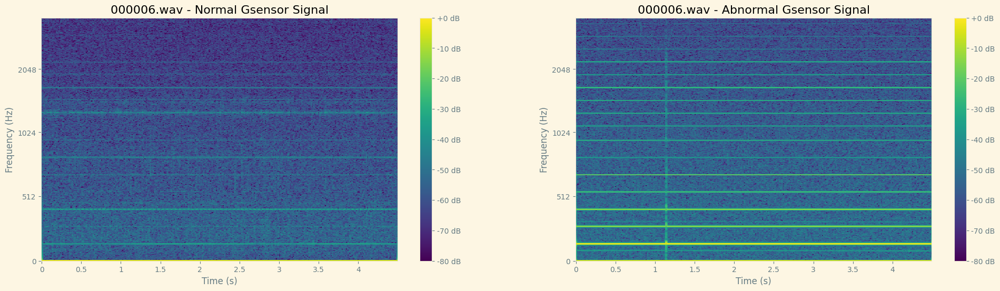

The spectrograms have a (1025, 422) shape.


In [16]:
# Gsensor Signal
hop_length = 512
normal_stft = np.abs(librosa.stft(normal_gsensor_signal, n_fft=n_fft, hop_length=hop_length))
normal_spectrogram = librosa.amplitude_to_db(normal_stft, ref=np.max)

abnormal_stft = np.abs(librosa.stft(abnormal_gsensor_signal, n_fft=n_fft, hop_length=hop_length))
abnormal_spectrogram = librosa.amplitude_to_db(abnormal_stft, ref=np.max)

fig = plt.figure(figsize=(24, 6))

plt.subplot(1, 2, 1)
librosa.display.specshow(
    normal_spectrogram, sr=sr1, x_axis="time", y_axis="mel", cmap="viridis"
)
plt.ylim(0, g_freq_limit) 
plt.title(f"{file_id} - Normal Gsensor Signal")
plt.colorbar(format="%+2.f dB")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")

plt.subplot(1, 2, 2)
librosa.display.specshow(
    abnormal_spectrogram, sr=sr1, x_axis="time", y_axis="mel", cmap="viridis"
)
plt.ylim(0, g_freq_limit) 
plt.title(f"{file_id} - Abnormal Gsensor Signal")
plt.ylabel("Frequency (Hz)")
plt.colorbar(format="%+2.f dB")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")

plt.show()
fig.savefig(os.path.join(IMAGE_PATH, "spectrograms.svg"), format="svg")

print(f"The spectrograms have a {normal_spectrogram.shape} shape.")

### Mel-spectrograms

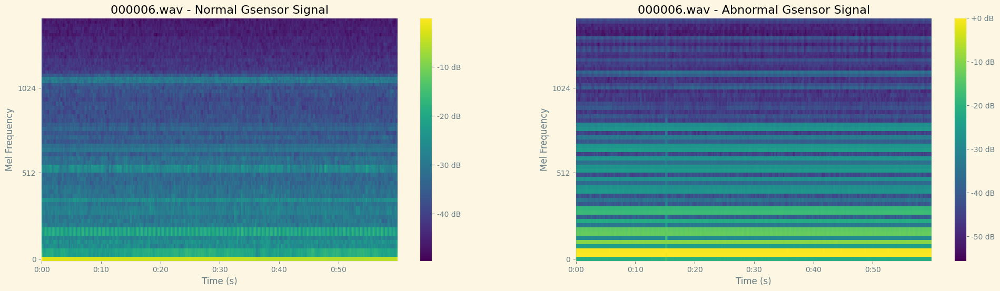

The mel-spectrograms have a (64, 422) shape.


In [17]:
# Sound Signal
n_mels = 64
normal_mel_spectrogram = librosa.feature.melspectrogram(
    y=normal_gsensor_signal, sr=sr2, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels
)
normal_mel_spectrogram = librosa.power_to_db(normal_mel_spectrogram, ref=np.max)

abnormal_mel_spectrogram = librosa.feature.melspectrogram(
    y=abnormal_gsensor_signal, sr=sr2, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels
)
abnormal_mel_spectrogram = librosa.power_to_db(abnormal_mel_spectrogram, ref=np.max)

fig = plt.figure(figsize=(24, 6))

plt.subplot(1, 2, 1)
librosa.display.specshow(
    normal_mel_spectrogram,
    sr=sr2,
    hop_length=hop_length,
    x_axis="time",
    y_axis="mel",
    cmap="viridis",
)
plt.title(f"{file_id} - Normal Gsensor Signal")
plt.xlabel("Time (s)")
plt.ylabel("Mel Frequency")
plt.colorbar(format="%+2.0f dB")

plt.subplot(1, 2, 2)
librosa.display.specshow(
    abnormal_mel_spectrogram,
    sr=sr2,
    hop_length=hop_length,
    x_axis="time",
    y_axis="mel",
    cmap="viridis",
)
plt.title(f"{file_id} - Abnormal Gsensor Signal")
plt.xlabel("Time (s)")
plt.ylabel("Mel Frequency")
plt.colorbar(format="%+2.0f dB")

plt.show()

fig.savefig(os.path.join(IMAGE_PATH, "mel_spectrograms.svg"), format="svg")

print(f"The mel-spectrograms have a {normal_mel_spectrogram.shape} shape.")


### Multiple Frames of Spectrograms

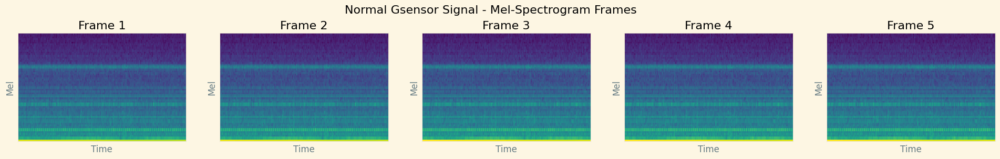

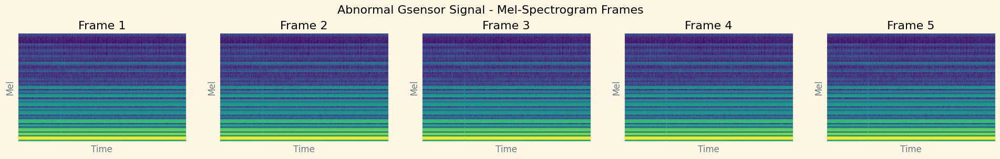

The features have a (418, 320) shape.


In [18]:
### Multiple Frames of Spectrograms
frames = 5
dims = frames * n_mels

# Normal Gsensor Signal
features_vector_size = normal_mel_spectrogram.shape[1] - frames + 1
features = np.zeros((features_vector_size, dims), np.float32)
for t in range(frames):
    features[:, n_mels * t : n_mels * (t + 1)] = normal_mel_spectrogram[:, t : t + features_vector_size].T

fig = plt.figure(figsize=(24, 3))
fig.suptitle("Normal Gsensor Signal - Mel-Spectrogram Frames", fontsize=16)

for t in range(frames):
    plt.subplot(1, frames, t + 1)
    librosa.display.specshow(
        features[:, n_mels * t : n_mels * (t + 1)].T,
        sr=sr1,
        hop_length=hop_length,
        cmap="viridis",
    )
    plt.title(f"Frame {t+1}")
    plt.xlabel("Time")
    plt.ylabel("Mel")

plt.subplots_adjust(top=0.80)
fig.savefig(os.path.join(IMAGE_PATH, "normal_frames.svg"), format="svg")

# Abnormal Gsensor Signal
features_vector_size = abnormal_mel_spectrogram.shape[1] - frames + 1
features = np.zeros((features_vector_size, dims), np.float32)
for t in range(frames):
    features[:, n_mels * t : n_mels * (t + 1)] = abnormal_mel_spectrogram[:, t : t + features_vector_size].T

fig = plt.figure(figsize=(24, 3))
fig.suptitle("Abnormal Gsensor Signal - Mel-Spectrogram Frames", fontsize=16)

for t in range(frames):
    plt.subplot(1, frames, t + 1)
    librosa.display.specshow(
        features[:, n_mels * t : n_mels * (t + 1)].T,
        sr=sr1,
        hop_length=hop_length,
        cmap="viridis",
    )
    plt.title(f"Frame {t+1}")
    plt.xlabel("Time")
    plt.ylabel("Mel")

plt.subplots_adjust(top=0.80)
plt.show()
fig.savefig(os.path.join(IMAGE_PATH, "abnormal_frames.svg"), format="svg")

print(f"The features have a {features.shape} shape.")


## Preprocessing

In [38]:
from utils.sound_utils import extract_sound_features, extract_gsensor_features

time_step = 2
frame_time_sec = 0.01

hop_length_sound = int(frame_time_sec * 48000)   # sound sample rate = 48kHz
hop_length_gsensor = int(frame_time_sec * 3600) 

nor_snd_feas = extract_sound_features(normal_sound_signal, sr1, n_fft=n_fft, hop_length=hop_length_sound, n_mels=64, fmax=s_freq_limit, per_frame_zscore=True)
ab_snd_feas = extract_sound_features(abnormal_sound_signal, sr1, n_fft=n_fft, hop_length=hop_length_sound, n_mels=64, fmax=s_freq_limit, per_frame_zscore=True)

nor_gsensor_feas = extract_gsensor_features(normal_gsensor_signal, sr2, n_fft=n_fft, hop_length=hop_length_gsensor, n_mels=12, per_frame_zscore=True)
ab_gsensor_feas = extract_gsensor_features(abnormal_gsensor_signal, sr2, n_fft=n_fft, hop_length=hop_length_gsensor, n_mels=12, per_frame_zscore=True)

In [39]:
# --- ensure 2D then flatten ---
def _to_numpy_2d(x):
    """Accept torch.Tensor or np.ndarray; ensure 2D"""
    if hasattr(x, "detach"):  # torch.Tensor-like
        x = x.detach().cpu().numpy()
    x = np.asarray(x)
    if x.ndim == 1:
        x = x[None, :]
    return x

snd_normal_vals = _to_numpy_2d(nor_snd_feas).ravel()
snd_abnorm_vals = _to_numpy_2d(ab_snd_feas).ravel()
gs_normal_vals  = _to_numpy_2d(nor_gsensor_feas).ravel()
gs_abnorm_vals  = _to_numpy_2d(ab_gsensor_feas).ravel()


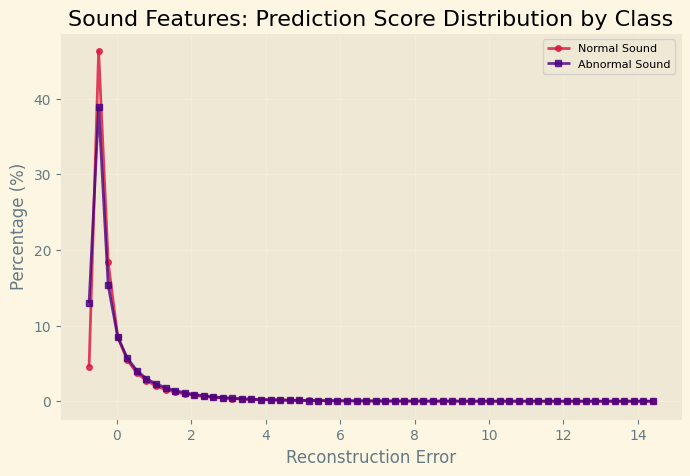

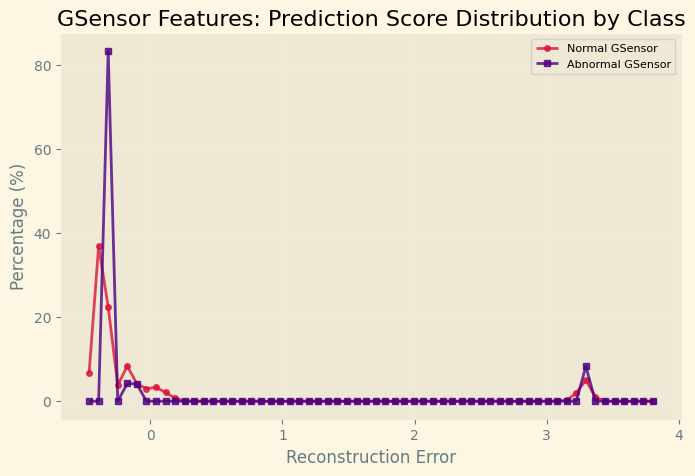

In [40]:
num_bins = 60  # 跟你先前一致
snd_min = min(snd_normal_vals.min(), snd_abnorm_vals.min())
snd_max = max(snd_normal_vals.max(), snd_abnorm_vals.max())
snd_bins = np.linspace(snd_min, snd_max, num_bins + 1)

# --- Overlapped percentage curves (Sound) ---
plot_histogram_by_class(
    snd_normal_vals, snd_abnorm_vals,
    bins=[snd_bins, snd_bins],                     # shared bins
    class_name=["Normal Sound", "Abnormal Sound"],
    model_name="Sound Features",
    file_name=None
)

# --- Shared bins (GSensor) ---
gs_min = min(gs_normal_vals.min(), gs_abnorm_vals.min())
gs_max = max(gs_normal_vals.max(), gs_abnorm_vals.max())
gs_bins = np.linspace(gs_min, gs_max, num_bins + 1)

plot_histogram_by_class(
    gs_normal_vals, gs_abnorm_vals,
    bins=[gs_bins, gs_bins],
    class_name=["Normal GSensor", "Abnormal GSensor"],
    model_name="GSensor Features",
    file_name=None
)